# Imports

In [1]:
from cohirf.experiment.spherical_clustering import generate_spherical_clusters, visualize_3d_data
from cohirf.models.kernel_kmeans import KernelKMeans
from cohirf.models.batch_cohirf import BatchCoHiRF
from cohirf.models.cohirf import ModularCoHiRF
from cohirf.models.pseudo_kernel import PseudoKernelClustering
from ml_experiments.tuners import OptunaTuner
from ml_experiments.utils import unflatten_dict, update_recursively
from sklearn.metrics import adjusted_rand_score
from sklearn.kernel_approximation import Nystroem, RBFSampler, PolynomialCountSketch
from sklearn.decomposition import PCA, KernelPCA
from sklearn.cluster import KMeans, HDBSCAN, DBSCAN, OPTICS
import optuna
from functools import partial
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from matplotlib.colors import ListedColormap
from types import SimpleNamespace
import plotly.express as px
from pathlib import Path

In [2]:
def training_fn(trial, model_cls, model_kwargs, X, y):
    params = trial.params
    parsed_params = unflatten_dict(params)
    parsed_params = update_recursively(parsed_params, model_kwargs)
    model = model_cls(**parsed_params)
    labels = model.fit_predict(X)
    # if -1 in labels (for example noise data for DBSCAN) we offset it to the last cluster
    if -1 in labels:
        labels = np.where(labels == -1, np.max(labels) + 1, labels)
    return adjusted_rand_score(y, labels)

In [3]:
def training_fn_batch(trial, model_cls, model_kwargs, X, y, batch_size):
    params = trial.params
    parsed_params = unflatten_dict(params)
    parsed_params = update_recursively(parsed_params, model_kwargs)
    model = model_cls(**parsed_params)
    labels = model.fit_predict(X)
    labels_per_batch = [labels[i * batch_size : (i + 1) * batch_size] for i in range(len(labels) // batch_size)]
    y_per_batch = [y[i * batch_size : (i + 1) * batch_size] for i in range(len(y) // batch_size)]
    ari_scores = [
        adjusted_rand_score(y_batch, labels_batch) for y_batch, labels_batch in zip(y_per_batch, labels_per_batch)
    ]
    # Return the mean ARI score across all batches
    return np.mean(ari_scores)

In [4]:
def train_best_model_and_show_results(model_cls, model_kwargs, study, X, y):
    best_params = study.best_params
    best_value = study.best_value
    print(f"Best parameters: {best_params}, Best Value: {best_value:.3f}")
    best_params = unflatten_dict(best_params)
    best_params = update_recursively(best_params, model_kwargs)
    best_model = model_cls(**best_params)
    labels = best_model.fit_predict(X)
    # if -1 in labels (for example noise data for DBSCAN) we offset it to the last cluster
    if -1 in labels:
        labels = np.where(labels == -1, np.max(labels) + 1, labels)
    ari = adjusted_rand_score(y, labels)
    n_clusters = len(np.unique(labels))
    fig, ax = plt.subplots(figsize=(8, 8), subplot_kw={"projection": "3d"})
    palette = sns.color_palette()
    cmap = ListedColormap(palette.as_hex())
    ax.scatter(X[:, 0], X[:, 1], X[:, 2], c=labels, cmap=cmap, s=2, vmin=0, vmax=10)
    ax.set_title(f"Best {model_cls.__name__}: ARI {ari:.3f}, Clusters {n_clusters}")
    plt.show()
    return best_model, labels

# Dataset

In [5]:
# dataset parameters
mean_r = [0.5, 1]  # Mean radii of the spheres
std = 0.01  # Standard deviation for the radii
seed_dataset = 42
n_samples = int(2e3)
n_samples_per_sphere = int(n_samples/2)  # Number of samples per sphere
X, y = generate_spherical_clusters(
    mean_r, std, num_points_per_sphere=n_samples_per_sphere, seed=seed_dataset
)

In [ ]:
fig = px.scatter_3d(x=X[:, 0], y=X[:, 1], z=X[:, 2], color=y)
fig.write_html(Path()/'original.html')  # Increase speed by lowering the value

In [ ]:
transform = KernelPCA(kernel="rbf", gamma=1, n_components=4)
X_transformed = transform.fit_transform(X)

In [ ]:
X_transformed.shape

(2000, 3)

In [ ]:
fig = px.scatter_3d(x=X_transformed[:, 0], y=X_transformed[:, 1], z=X_transformed[:, 3], color=y)
fig.write_html(Path() / "transformed.html")  # Increase speed by lowering the value

## KMeans

In [8]:
random_state_model = 42000
model = KMeans(n_clusters=2, random_state=random_state_model)
model.fit(X)
# model.fit(X_transformed[:, [0,1,3]])  # Using only the last component for clustering
labels = model.labels_
ari = adjusted_rand_score(y, labels)
print(f"KMeans ARI: {ari:.3f}, Clusters: {len(np.unique(labels))}")
fig = px.scatter_3d(x=X[:, 0], y=X[:, 1], z=X[:, 2], color=labels)
fig.show()

KMeans ARI: -0.000, Clusters: 2


## Kernel KMeans (rbf)

In [9]:
random_state_model = 42000
model_cls = KernelKMeans
search_space = {
    "gamma": optuna.distributions.FloatDistribution(0.1, 20),
}
model_kwargs = {
    "n_clusters": 2,
    "kernel": "rbf",
    "random_state": random_state_model,
}
training_fn_partial = partial(training_fn, model_cls=model_cls, model_kwargs=model_kwargs, X=X, y=y)
tuner = OptunaTuner(sampler="tpe", n_trials=20, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``multivariate`` is an experimental feature. The interface can change in the future.

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``constant_liar`` is an experimental feature. The interface can change in the future.

[I 2025-06-02 18:19:42,516] A new study created in memory with name: no-name-a6dfd3d3-daf4-43a9-b4ab-b9c9fc0da577


Trials:   0%|          | 0/20 [00:00<?, ?it/s]

Best parameters: {'gamma': 17.33151535840103}, Best Value: 0.219


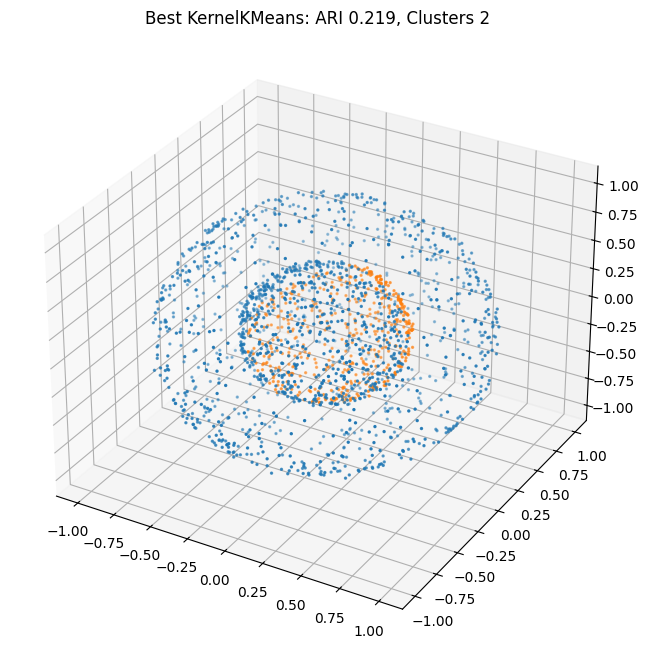

In [10]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## Kernel KMeans (poly)

In [11]:
random_state_model = 42000
model_cls = KernelKMeans
search_space = {
    "gamma": optuna.distributions.FloatDistribution(0.1, 20),
}
model_kwargs = {
    "n_clusters": 2,
    "kernel": "poly",
    "random_state": random_state_model,
}
training_fn_partial = partial(
    training_fn, model_cls=model_cls, model_kwargs=model_kwargs, X=X, y=y
)
tuner = OptunaTuner(sampler="tpe", n_trials=20, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``multivariate`` is an experimental feature. The interface can change in the future.

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``constant_liar`` is an experimental feature. The interface can change in the future.

[I 2025-06-02 18:20:27,105] A new study created in memory with name: no-name-693c8a83-2cfd-4bc4-88f6-ea38276e6b7e


Trials:   0%|          | 0/20 [00:00<?, ?it/s]

Best parameters: {'gamma': 15.03490458041071}, Best Value: 0.184


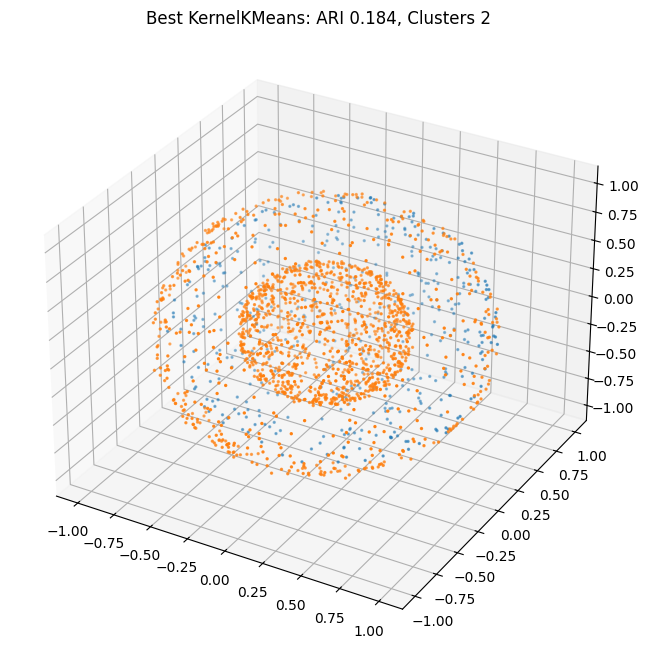

In [12]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## Pseudo Kernel KMeans (rbf)

In [13]:
random_state_model = 42000
model_cls = PseudoKernelClustering
search_space = {
    'transform_kwargs': {
        'gamma': optuna.distributions.FloatDistribution(0.1, 20),
        },
}
model_kwargs = {
    'base_model': KMeans,
    'base_model_kwargs': {'n_clusters': 2 ,'random_state': random_state_model},
    'transform_method': RBFSampler,
    'transform_kwargs': {'n_components': 500, 'random_state': random_state_model},
}
training_fn_partial = partial(training_fn, model_cls=model_cls, model_kwargs=model_kwargs, X=X,
                             y=y)
tuner = OptunaTuner(sampler='tpe', n_trials=20, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``multivariate`` is an experimental feature. The interface can change in the future.

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``constant_liar`` is an experimental feature. The interface can change in the future.

[I 2025-06-02 18:21:41,353] A new study created in memory with name: no-name-f52febe6-84ab-47e0-9050-86c44df448d3


Trials:   0%|          | 0/20 [00:00<?, ?it/s]

Best parameters: {'transform_kwargs/gamma': 19.939919998571046}, Best Value: 0.300


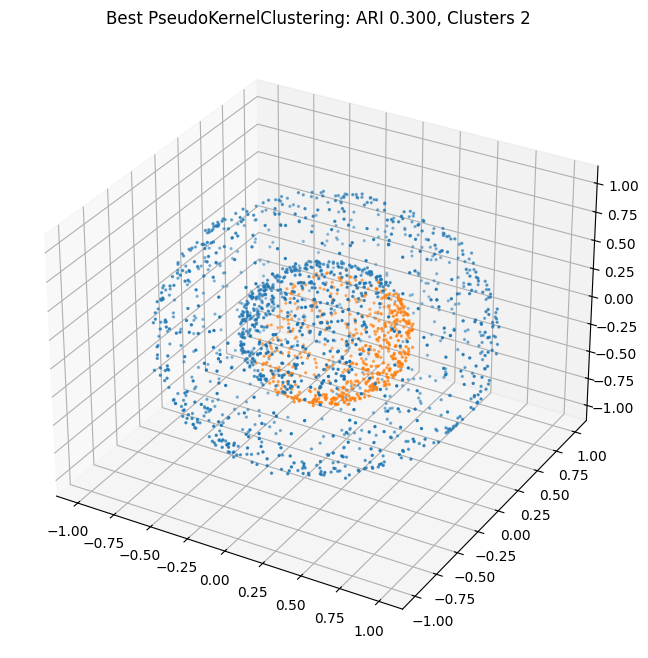

In [14]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## Pseudo Kernel KMeans (poly)

In [15]:
random_state_model = 42000
model_cls = PseudoKernelClustering
search_space = {
    "transform_kwargs": {
        "gamma": optuna.distributions.FloatDistribution(0.1, 20),
    },
}
model_kwargs = {
    "base_model": KMeans,
    "base_model_kwargs": {"n_clusters": 2, "random_state": random_state_model},
    "transform_method": Nystroem,
    "transform_kwargs": {"n_components": 500, "kernel": "poly", "degree": 3, "coef0":1, "random_state": random_state_model},
}
training_fn_partial = partial(training_fn, model_cls=model_cls, model_kwargs=model_kwargs, X=X, y=y)
tuner = OptunaTuner(sampler="tpe", n_trials=20, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``multivariate`` is an experimental feature. The interface can change in the future.

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``constant_liar`` is an experimental feature. The interface can change in the future.

[I 2025-06-02 18:21:49,505] A new study created in memory with name: no-name-62290b60-c20a-4f5f-8521-7d21c5db64fa


Trials:   0%|          | 0/20 [00:00<?, ?it/s]

Best parameters: {'transform_kwargs/gamma': 2.731915083410665}, Best Value: 0.174


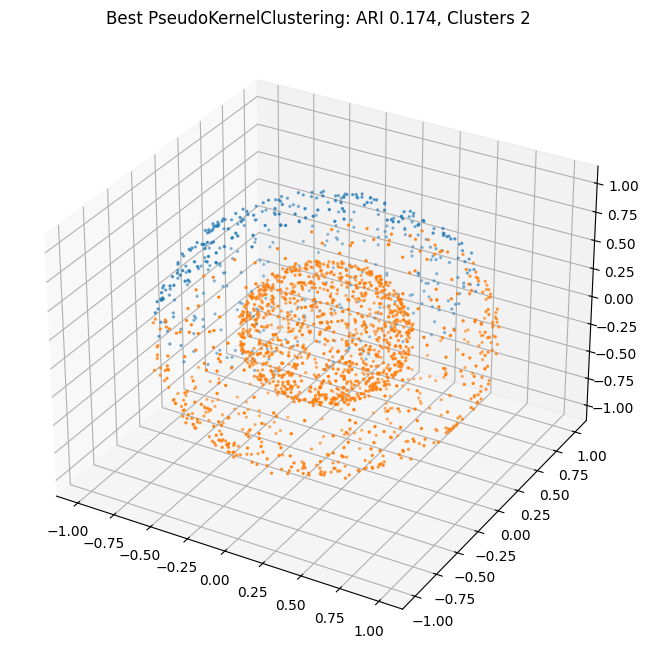

In [16]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## Pseudo Kernel KMeans KernelPCA

In [17]:
random_state_model = 42000
model_cls = PseudoKernelClustering
search_space = {
    "transform_kwargs": {
        "gamma": optuna.distributions.FloatDistribution(0.1, 20),
    },
}
model_kwargs = {
    "base_model": KMeans,
    "base_model_kwargs": {"n_clusters": 2, "random_state": random_state_model},
    "transform_method": KernelPCA,
    "transform_kwargs": {
        "n_components": 5,
        "kernel": "rbf",
        "random_state": random_state_model,
    },
}
training_fn_partial = partial(training_fn, model_cls=model_cls, model_kwargs=model_kwargs, X=X, y=y)
tuner = OptunaTuner(sampler="tpe", n_trials=20, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``multivariate`` is an experimental feature. The interface can change in the future.

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``constant_liar`` is an experimental feature. The interface can change in the future.

[I 2025-06-02 18:22:04,300] A new study created in memory with name: no-name-d44c34de-c842-49e8-a1e0-d872377caa6a


Trials:   0%|          | 0/20 [00:00<?, ?it/s]

Best parameters: {'transform_kwargs/gamma': 4.055422593206281}, Best Value: 0.217


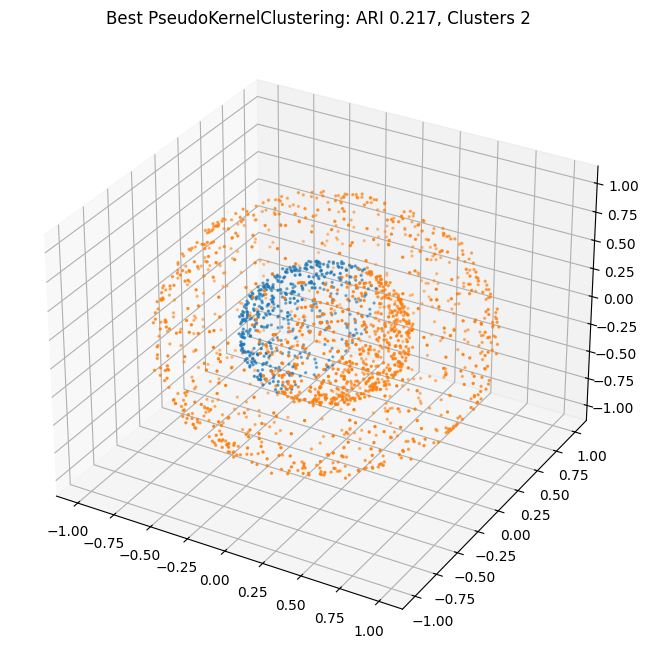

In [18]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## CoHiRF

In [19]:
random_state_model = 42000
model_cls = ModularCoHiRF
search_space = {
    'repetitions': optuna.distributions.IntDistribution(2, 10),
    'n_features': optuna.distributions.IntDistribution(2, 3),
    'base_model_kwargs': {
        'n_clusters': optuna.distributions.IntDistribution(2, 5),
    }
}
model_kwargs = {
    'base_model': KMeans,
    'random_state': random_state_model,
}
training_fn_partial = partial(training_fn, model_cls=model_cls, model_kwargs=model_kwargs, X=X,
                             y=y)
tuner = OptunaTuner(sampler='tpe', n_trials=100, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``multivariate`` is an experimental feature. The interface can change in the future.

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``constant_liar`` is an experimental feature. The interface can change in the future.

[I 2025-06-02 18:22:15,771] A new study created in memory with name: no-name-ce5be73f-4b0e-4f23-a2fc-b5dd1dc7e5c4


Trials:   0%|          | 0/100 [00:00<?, ?it/s]

Best parameters: {'repetitions': 9, 'n_features': 2, 'base_model_kwargs/n_clusters': 5}, Best Value: 0.002


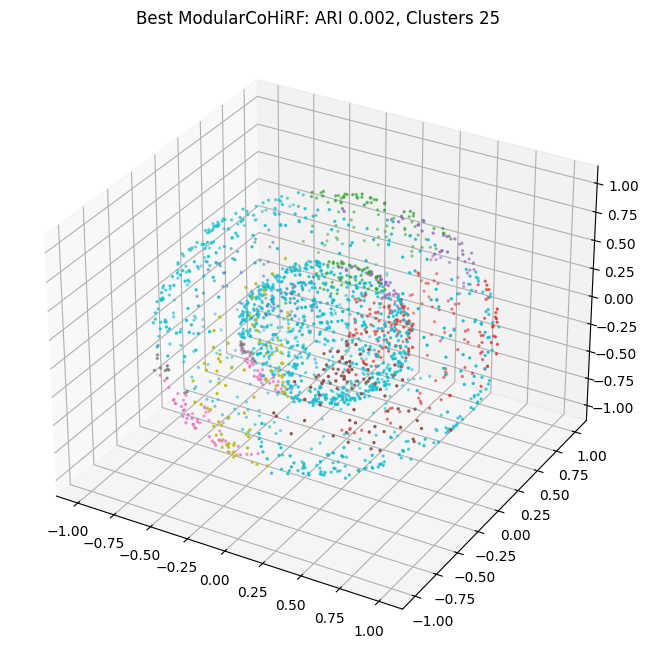

In [20]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## Kernel CoHiRF

In [21]:
random_state_model = 42000
model_cls = ModularCoHiRF
search_space = {
    "repetitions": optuna.distributions.IntDistribution(2, 10),
    "base_model_kwargs": {
        "n_clusters": optuna.distributions.IntDistribution(2, 5),
        "gamma": optuna.distributions.FloatDistribution(0.1, 30),
    },
    "n_features": optuna.distributions.IntDistribution(2, 3),
}
model_kwargs = {
    'representative_method': 'rbf',
    'base_model': KernelKMeans,
    'base_model_kwargs': {'kernel': 'rbf'},
    'random_state': random_state_model,
}
training_fn_partial = partial(training_fn, model_cls=model_cls, model_kwargs=model_kwargs, X=X,
                             y=y)
tuner = OptunaTuner(sampler='tpe', n_trials=20, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``multivariate`` is an experimental feature. The interface can change in the future.

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``constant_liar`` is an experimental feature. The interface can change in the future.

[I 2025-06-02 18:22:42,109] A new study created in memory with name: no-name-028d2cec-8c47-4e09-ae5a-296500a717bc


Trials:   0%|          | 0/20 [00:00<?, ?it/s]

Best parameters: {'repetitions': 2, 'base_model_kwargs/n_clusters': 3, 'base_model_kwargs/gamma': 29.6041928548228, 'n_features': 3}, Best Value: 0.574


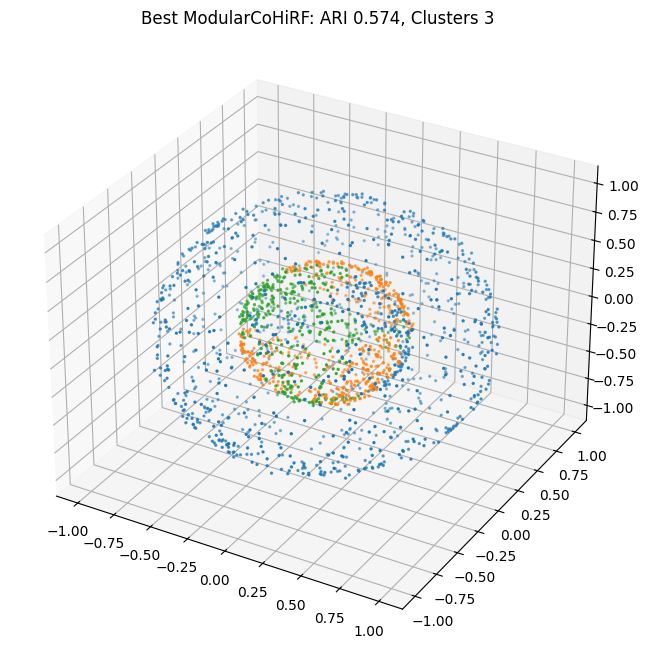

In [22]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## Approx. Kernel CoHiRF

In [23]:
random_state_model = 42000
model_cls = ModularCoHiRF
search_space = {
    "repetitions": optuna.distributions.IntDistribution(2, 10),
    "transform_kwargs": {
        "gamma": optuna.distributions.FloatDistribution(0.1, 30),
    },
    "base_model_kwargs": {
        "n_clusters": optuna.distributions.IntDistribution(2, 5),
    },
    "n_features": optuna.distributions.IntDistribution(2, 3),
}
model_kwargs = {
    "representative_method": "rbf",
    "base_model": KMeans,
    "transform_method": RBFSampler,
    "transform_kwargs": {"n_components": 500},
    "random_state": random_state_model,
}
training_fn_partial = partial(
    training_fn, model_cls=model_cls, model_kwargs=model_kwargs, X=X, y=y
)
tuner = OptunaTuner(sampler="tpe", n_trials=100, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``multivariate`` is an experimental feature. The interface can change in the future.

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``constant_liar`` is an experimental feature. The interface can change in the future.

[I 2025-06-02 18:26:27,347] A new study created in memory with name: no-name-4bca93c4-71a3-45a5-8a54-cfbc2cc07b6b


Trials:   0%|          | 0/100 [00:00<?, ?it/s]

Best parameters: {'repetitions': 2, 'transform_kwargs/gamma': 10.107494928835635, 'base_model_kwargs/n_clusters': 4, 'n_features': 3}, Best Value: 0.708


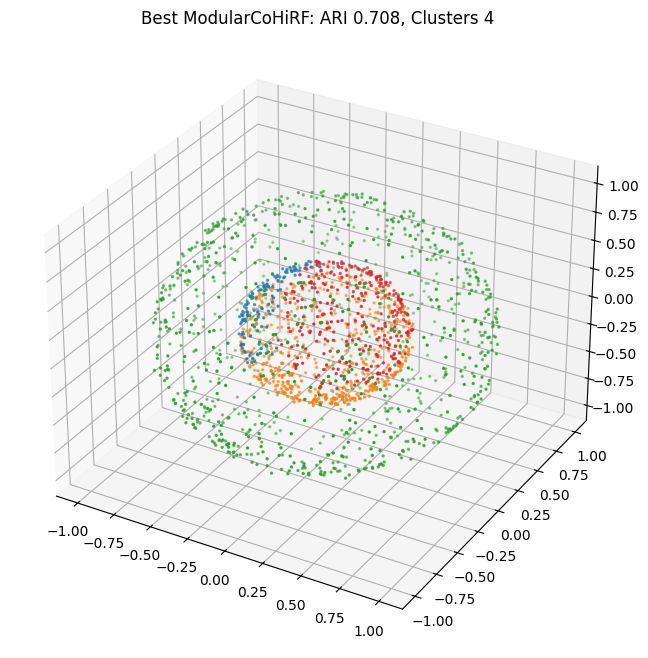

In [24]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## HDBSCAN

In [25]:
random_state_model = 42000
model_cls = HDBSCAN
search_space = {
    "min_cluster_size": optuna.distributions.IntDistribution(5, 50),
}
model_kwargs = {
    "n_jobs": 10,
}
training_fn_partial = partial(training_fn, model_cls=model_cls, model_kwargs=model_kwargs, X=X, y=y)
tuner = OptunaTuner(sampler="tpe", n_trials=100, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``multivariate`` is an experimental feature. The interface can change in the future.

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``constant_liar`` is an experimental feature. The interface can change in the future.

[I 2025-06-02 18:28:46,025] A new study created in memory with name: no-name-5840f856-ce84-4018-9b51-7c697b410807


Trials:   0%|          | 0/100 [00:00<?, ?it/s]

Best parameters: {'min_cluster_size': 10}, Best Value: 1.000


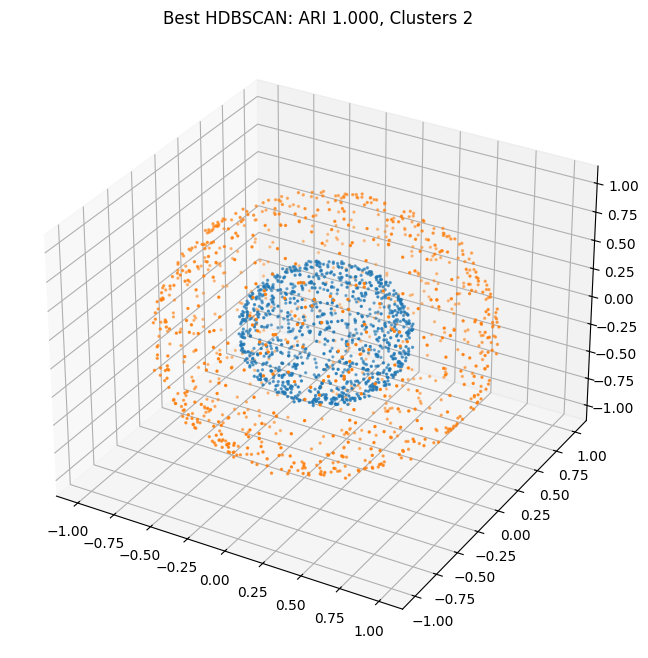

In [26]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## DBSCAN

In [27]:
random_state_model = 42000
model_cls = DBSCAN
search_space = {
    "eps": optuna.distributions.FloatDistribution(1e-1, 10),
    "min_samples": optuna.distributions.IntDistribution(5, 50),
}
model_kwargs = {
    "n_jobs": 10,
}
training_fn_partial = partial(training_fn, model_cls=model_cls, model_kwargs=model_kwargs, X=X, y=y)
tuner = OptunaTuner(sampler="tpe", n_trials=100, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``multivariate`` is an experimental feature. The interface can change in the future.

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``constant_liar`` is an experimental feature. The interface can change in the future.

[I 2025-06-02 18:28:59,209] A new study created in memory with name: no-name-19f8bb3a-8972-4203-a778-f036f6e8617e


Trials:   0%|          | 0/100 [00:00<?, ?it/s]

Best parameters: {'eps': 0.27609249175355666, 'min_samples': 8}, Best Value: 1.000


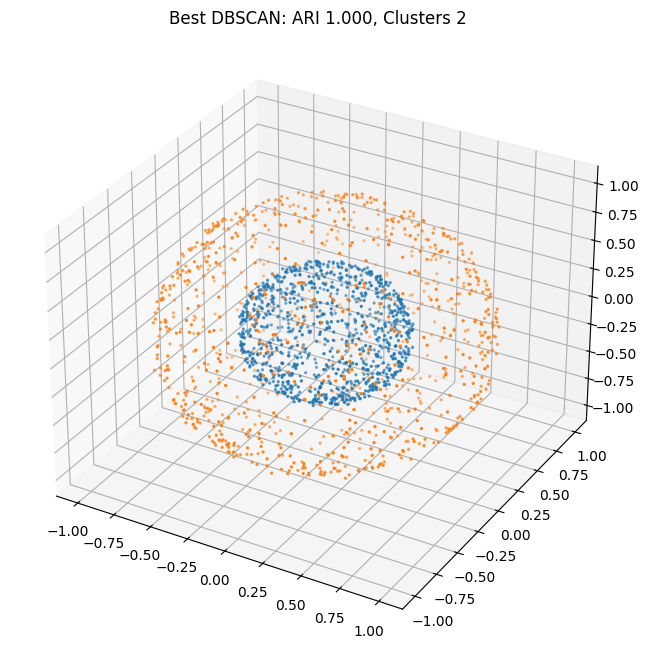

In [28]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## OPTICS

In [29]:
random_state_model = 42000
model = OPTICS(cluster_method='dbscan', min_samples=10, max_eps=0.3)
model.fit(X)  # Using only the last component for clustering
labels = model.labels_
ari = adjusted_rand_score(y, labels)
print(f"KMeans ARI: {ari:.3f}, Clusters: {len(np.unique(labels))}")
fig = px.scatter_3d(x=X[:, 0], y=X[:, 1], z=X[:, 2], color=labels)
fig.show()

KMeans ARI: 1.000, Clusters: 2


# Dataset with radius

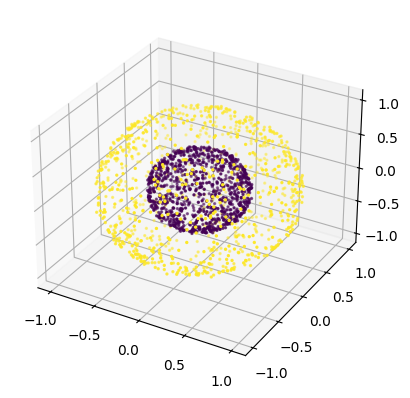

In [8]:
# dataset parameters
mean_r = [0.5, 1]  # Mean radii of the spheres
std = 0.01  # Standard deviation for the radii
seed_dataset = 42
n_samples = int(2e3)
n_samples_per_sphere = int(n_samples / 2)  # Number of samples per sphere
X, y = generate_spherical_clusters(
    mean_r, std, num_points_per_sphere=n_samples_per_sphere, seed=seed_dataset
)
visualize_3d_data(X, y)
X = np.hstack((X, np.sum(X**2, axis=1, keepdims=True)))

## KMeans

Best parameters: {'n_clusters': 2, 'random_state': 42000}, Best Value: 0.000


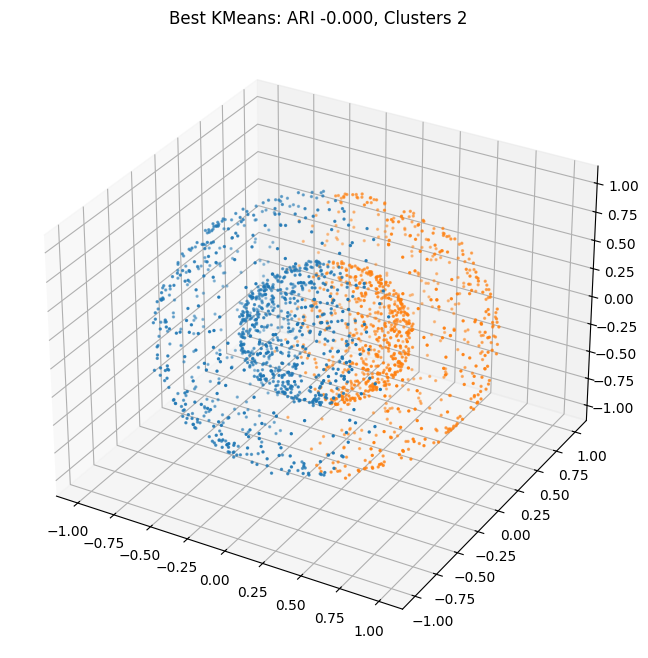

In [52]:
random_state_model = 42000
best_params = dict(n_clusters=2, random_state=random_state_model)
model_cls = KMeans
study = SimpleNamespace()
study.best_params = unflatten_dict(best_params)
study.best_value = 0  # Dummy value for demonstration purposes
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs=dict(), study=study, X=X, y=y)

## Kernel KMeans

In [53]:
random_state_model = 42000
model_cls = KernelKMeans
search_space = {
    "gamma": optuna.distributions.FloatDistribution(0.1, 20),
}
model_kwargs = {
    "n_clusters": 2,
    "kernel": "rbf",
    "random_state": random_state_model,
}
training_fn_partial = partial(
    training_fn, model_cls=model_cls, model_kwargs=model_kwargs, X=X, y=y
)
tuner = OptunaTuner(sampler="tpe", n_trials=20, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``multivariate`` is an experimental feature. The interface can change in the future.

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``constant_liar`` is an experimental feature. The interface can change in the future.

[I 2025-06-02 18:45:29,053] A new study created in memory with name: no-name-4bad9117-c2f2-4ddc-bffb-8144d0e2cf4a


Trials:   0%|          | 0/20 [00:00<?, ?it/s]

Best parameters: {'gamma': 2.435332138564481}, Best Value: 1.000


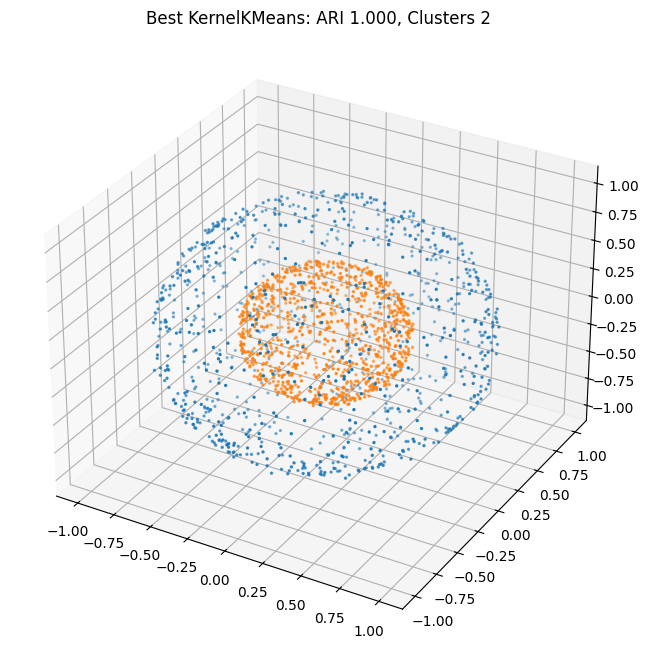

In [54]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## Approx. Kernel KMeans

In [55]:
random_state_model = 42000
model_cls = PseudoKernelClustering
search_space = {
    "transform_kwargs": {
        "gamma": optuna.distributions.FloatDistribution(0.1, 20),
    },
}
model_kwargs = {
    "base_model": KMeans,
    "base_model_kwargs": {"n_clusters": 2, "random_state": random_state_model},
    "transform_method": RBFSampler,
    "transform_kwargs": {"n_components": 500, "random_state": random_state_model},
}
training_fn_partial = partial(
    training_fn, model_cls=model_cls, model_kwargs=model_kwargs, X=X, y=y
)
tuner = OptunaTuner(sampler="tpe", n_trials=20, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``multivariate`` is an experimental feature. The interface can change in the future.

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``constant_liar`` is an experimental feature. The interface can change in the future.

[I 2025-06-02 18:46:00,007] A new study created in memory with name: no-name-919c4325-dd38-4f10-a03a-3076545a909e


Trials:   0%|          | 0/20 [00:00<?, ?it/s]

Best parameters: {'transform_kwargs/gamma': 2.435332138564481}, Best Value: 1.000


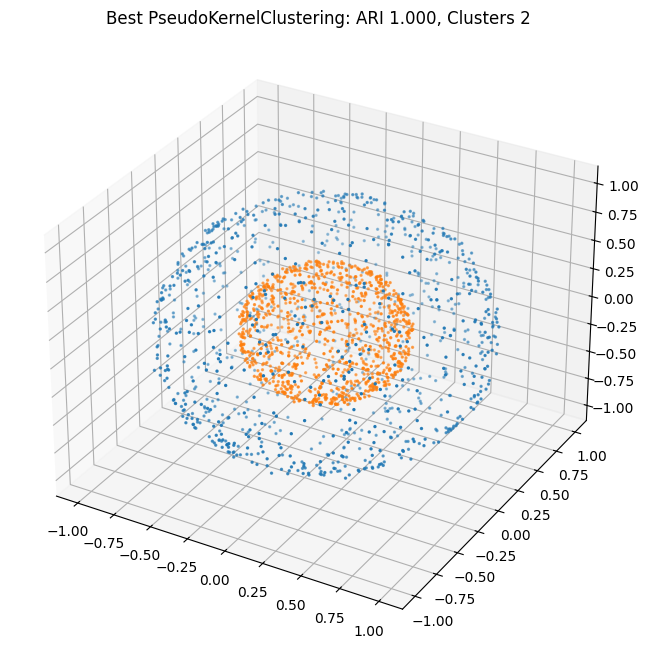

In [56]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## CoHiRF KMeans

In [57]:
random_state_model = 42000
model_cls = ModularCoHiRF
search_space = {
    'repetitions': optuna.distributions.IntDistribution(2, 10),
    'base_model_kwargs': {
        'n_clusters': optuna.distributions.IntDistribution(2, 5),
    },
    'n_features': optuna.distributions.IntDistribution(2, 4),
}
model_kwargs = {
    'representative_method': 'closest_overall',
    'base_model': KMeans,
    'random_state': random_state_model,
    'sample_than_transform': True,
}
training_fn_partial = partial(
    training_fn, model_cls=model_cls, model_kwargs=model_kwargs, X=X, y=y
)
tuner = OptunaTuner(sampler='tpe', n_trials=20, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``multivariate`` is an experimental feature. The interface can change in the future.

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``constant_liar`` is an experimental feature. The interface can change in the future.

[I 2025-06-02 18:46:12,266] A new study created in memory with name: no-name-cb25ec66-9c5a-48e1-9d65-f6b97a3de1aa


Trials:   0%|          | 0/20 [00:00<?, ?it/s]

Best parameters: {'repetitions': 3, 'base_model_kwargs/n_clusters': 5, 'n_features': 3}, Best Value: 0.622


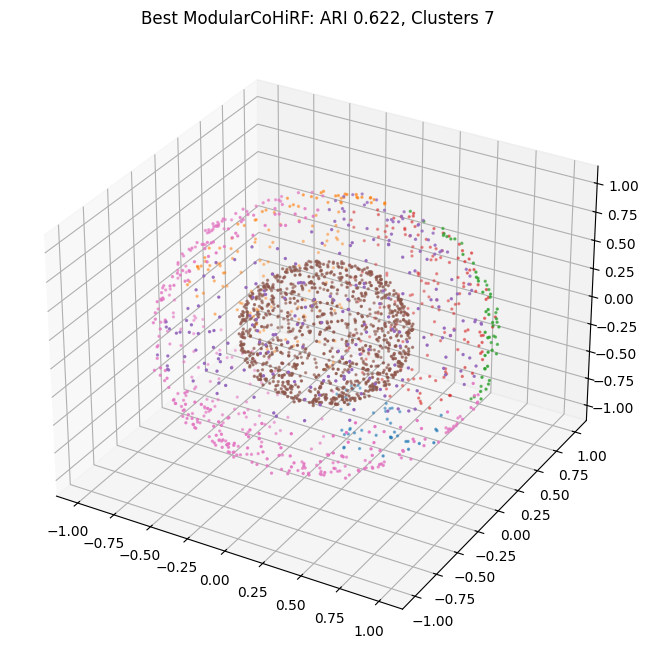

In [58]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## CoHiRF Kernel KMeans

In [59]:
random_state_model = 42000
model_cls = ModularCoHiRF
search_space = {
    "repetitions": optuna.distributions.IntDistribution(2, 10),
    "base_model_kwargs": {
        "n_clusters": optuna.distributions.IntDistribution(2, 5),
        "gamma": optuna.distributions.FloatDistribution(0.1, 30),
    },
    "n_features": optuna.distributions.IntDistribution(2, 4),
}
model_kwargs = {
    "representative_method": "rbf",
    "base_model": KernelKMeans,
    "base_model_kwargs": {"kernel": "rbf"},
    "random_state": random_state_model,
}
training_fn_partial = partial(
    training_fn, model_cls=model_cls, model_kwargs=model_kwargs, X=X, y=y
)
tuner = OptunaTuner(sampler="tpe", n_trials=20, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``multivariate`` is an experimental feature. The interface can change in the future.

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``constant_liar`` is an experimental feature. The interface can change in the future.

[I 2025-06-02 18:46:34,042] A new study created in memory with name: no-name-3ae0ee57-d010-4295-8add-e8981ec0e880


Trials:   0%|          | 0/20 [00:00<?, ?it/s]

Best parameters: {'repetitions': 5, 'base_model_kwargs/n_clusters': 2, 'base_model_kwargs/gamma': 3.781264420037263, 'n_features': 4}, Best Value: 1.000


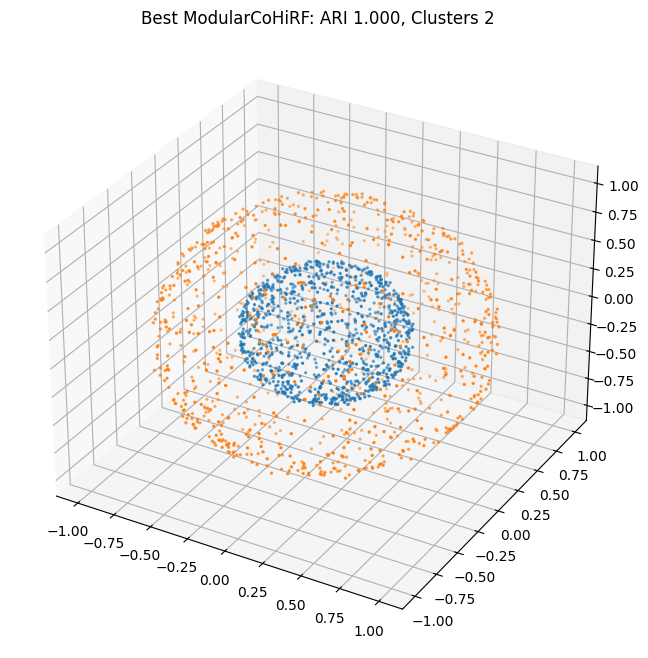

In [60]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## CoHiRF Approx. Kernel KMeans

In [61]:
random_state_model = 42000
model_cls = ModularCoHiRF
search_space = {
    'repetitions': optuna.distributions.IntDistribution(2, 10),
    'transform_kwargs': {
        'gamma': optuna.distributions.FloatDistribution(0.1, 30),
        },
    'base_model_kwargs': {
        'n_clusters': optuna.distributions.IntDistribution(2, 5),
    },
    'n_features': optuna.distributions.IntDistribution(2, 4),
}
model_kwargs = {
    'representative_method': 'rbf',
    'base_model': KMeans,
    'transform_method': RBFSampler,
    'transform_kwargs': {'n_components': 500},
    'random_state': random_state_model,
    'sample_than_transform': True,
}
training_fn_partial = partial(
    training_fn, model_cls=model_cls, model_kwargs=model_kwargs, X=X, y=y
)
tuner = OptunaTuner(sampler='tpe', n_trials=20, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``multivariate`` is an experimental feature. The interface can change in the future.

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``constant_liar`` is an experimental feature. The interface can change in the future.

[I 2025-06-02 18:49:48,124] A new study created in memory with name: no-name-4219b915-5067-44df-a97e-bb7f019d0170


Trials:   0%|          | 0/20 [00:00<?, ?it/s]

Best parameters: {'repetitions': 2, 'transform_kwargs/gamma': 4.904877640924428, 'base_model_kwargs/n_clusters': 2, 'n_features': 3}, Best Value: 1.000


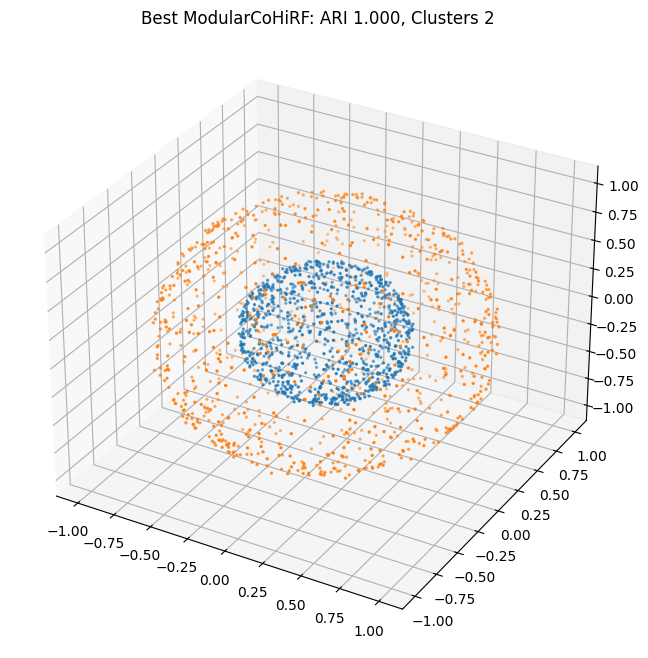

In [62]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## Batch CoHiRF KMeans Optimization All

In [49]:
random_state_model = 42000
model_cls = BatchCoHiRF
search_space = {
    "cohirf_kwargs": {
        "repetitions": optuna.distributions.IntDistribution(2, 10),
        "n_features": optuna.distributions.IntDistribution(2, 4),
        "base_model_kwargs": {
            "n_clusters": optuna.distributions.IntDistribution(2, 5),
        }
    },
}
model_kwargs = {
    "cohirf_model": ModularCoHiRF,
    "cohirf_kwargs": dict(base_model=KMeans, random_state=random_state_model, max_iter=1),
    "batch_size": int(5e2),
}
training_fn_partial = partial(
    training_fn, model_cls=model_cls, model_kwargs=model_kwargs, X=X, y=y
)
tuner = OptunaTuner(sampler="tpe", n_trials=20, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``multivariate`` is an experimental feature. The interface can change in the future.

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``constant_liar`` is an experimental feature. The interface can change in the future.

[I 2025-06-02 18:45:08,717] A new study created in memory with name: no-name-f0692144-3d1f-43bf-8353-d81fa4e0bcf0


Trials:   0%|          | 0/20 [00:00<?, ?it/s]

Best parameters: {'cohirf_kwargs/repetitions': 2, 'cohirf_kwargs/n_features': 3, 'cohirf_kwargs/base_model_kwargs/n_clusters': 3}, Best Value: 0.671


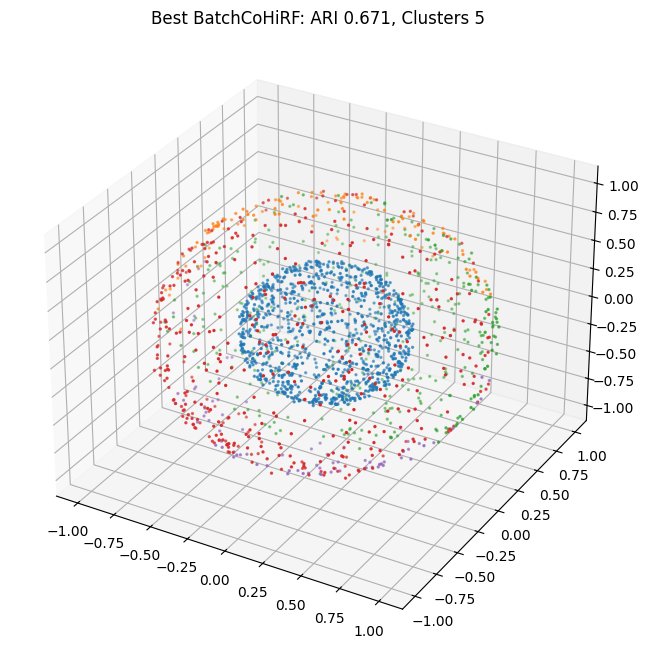

In [50]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## Batch CoHiRF KMeans Optimization first batch

In [ ]:
random_state_model = 42000
batch_size = int(5e2)
model_cls = BatchCoHiRF
search_space = {
    "cohirf_kwargs": {
        "repetitions": optuna.distributions.IntDistribution(2, 5),
        "n_features": optuna.distributions.IntDistribution(2, 4),
        "base_model_kwargs": {
            "n_clusters": optuna.distributions.IntDistribution(2, 5),
        },
    },
}
model_kwargs = {
    "cohirf_model": ModularCoHiRF,
    "cohirf_kwargs": dict(base_model=KMeans, random_state=random_state_model, max_iter=1),
    "batch_size": batch_size,
}
features_first_batch = X[:batch_size]
true_labels_first_batch = y[:batch_size]
training_fn_partial = partial(
    training_fn,
    model_cls=model_cls,
    model_kwargs=model_kwargs,
    X=features_first_batch,
    y=true_labels_first_batch,
)
tuner = OptunaTuner(sampler="tpe", n_trials=100, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning: Argument ``constant_liar`` is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-05-28 13:10:54,917] A new study created in memory with name: no-name-9ce3938a-9109-4bc4-a3a8-e43625f3df62


Trials:   0%|          | 0/100 [00:00<?, ?it/s]

Best parameters: {'cohirf_kwargs/repetitions': 2, 'cohirf_kwargs/n_features': 4, 'cohirf_kwargs/base_model_kwargs/n_clusters': 4}, Best Value: 0.687


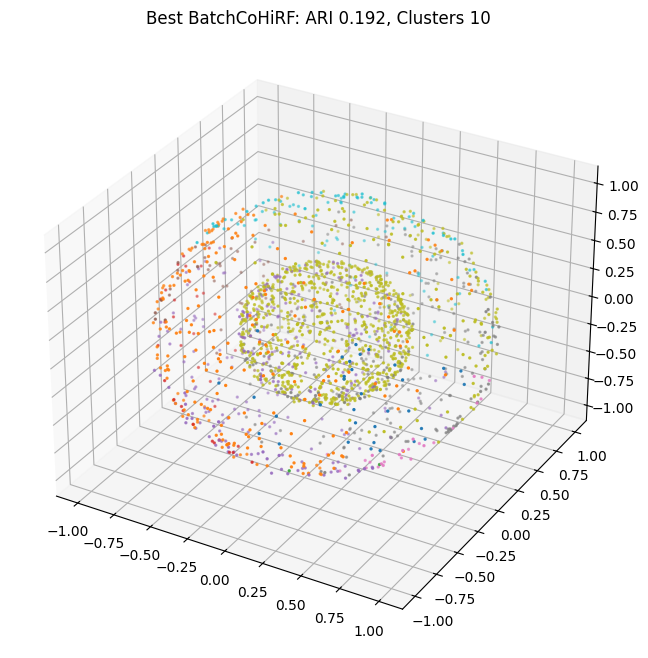

In [ ]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## Batch CoHiRF KMeans Optimization mean batchs

In [ ]:
random_state_model = 42000
batch_size = int(1e3)
model_cls = BatchCoHiRF
search_space = {
    "cohirf_kwargs": {
        "repetitions": optuna.distributions.IntDistribution(2, 5),
        "n_features": optuna.distributions.IntDistribution(2, 4),
        "base_model_kwargs": {
            "n_clusters": optuna.distributions.IntDistribution(2, 5),
        },
    },
}
model_kwargs = {
    "cohirf_model": ModularCoHiRF,
    "cohirf_kwargs": dict(base_model=KMeans, random_state=random_state_model, max_iter=1),
    "batch_size": batch_size,
    "max_epochs": 1,
}

training_fn_partial = partial(
    training_fn_batch, model_cls=model_cls, model_kwargs=model_kwargs, X=X, y=y, batch_size=batch_size
)
tuner = OptunaTuner(sampler="tpe", n_trials=100, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning: Argument ``constant_liar`` is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-05-28 20:32:19,627] A new study created in memory with name: no-name-403062b0-d334-4a07-b1e6-b35171ec2b47


Trials:   0%|          | 0/100 [00:00<?, ?it/s]

Best parameters: {'cohirf_kwargs/repetitions': 2, 'cohirf_kwargs/n_features': 3, 'cohirf_kwargs/base_model_kwargs/n_clusters': 4}, Best Value: 0.579
Starting epoch 0
Starting epoch 1
Getting labels from parents


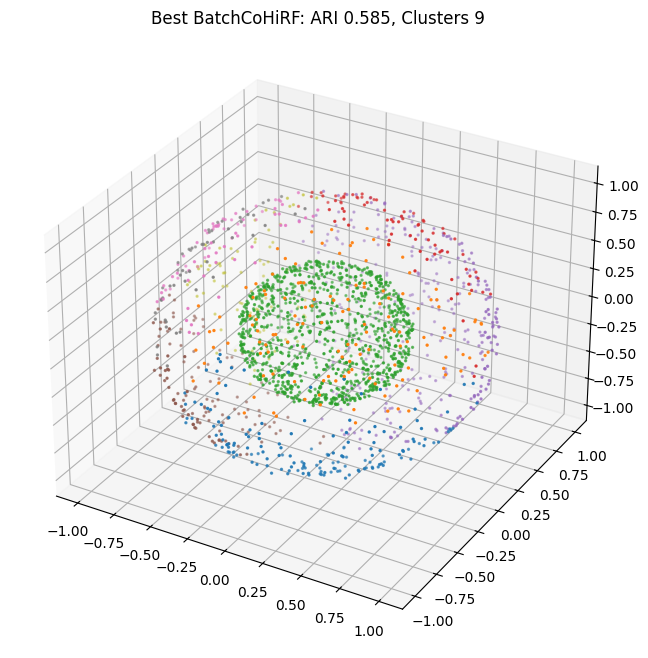

In [ ]:
model_kwargs["max_epochs"] = 10
model_kwargs["verbose"] = True
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## Batch CoHiRF Approx. Kernel KMeans Optimization All

### Max iter = 100

In [8]:
random_state_model = 42000
batch_size = int(2e2)
model_cls = BatchCoHiRF
search_space = {
    "cohirf_kwargs": {
        "repetitions": optuna.distributions.IntDistribution(2, 10),
        "n_features": optuna.distributions.IntDistribution(2, 4),
        "base_model_kwargs": {
            "n_clusters": optuna.distributions.IntDistribution(2, 5),
        },
        "transform_kwargs": {
            "gamma": optuna.distributions.FloatDistribution(0.1, 30),
        },
    },
}
model_kwargs = {
    "cohirf_model": ModularCoHiRF,
    "cohirf_kwargs": dict(
        base_model=KMeans,
        transform_method=RBFSampler,
        transform_kwargs={"n_components": 500},
        representative_method="rbf",
        random_state=random_state_model,
        sample_than_transform=True,
        max_iter=100,
    ),
    "batch_size": batch_size,
}
training_fn_partial = partial(
    training_fn,
    model_cls=model_cls,
    model_kwargs=model_kwargs,
    X=X,
    y=y,
)
tuner = OptunaTuner(sampler="tpe", n_trials=20, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning: Argument ``constant_liar`` is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-06-02 17:56:35,390] A new study created in memory with name: no-name-07bc4944-6b98-4369-9738-ccfb2ce27da1


Trials:   0%|          | 0/20 [00:00<?, ?it/s]

Best parameters: {'cohirf_kwargs/repetitions': 4, 'cohirf_kwargs/n_features': 2, 'cohirf_kwargs/base_model_kwargs/n_clusters': 2, 'cohirf_kwargs/transform_kwargs/gamma': 6.025764470362989}, Best Value: 0.999


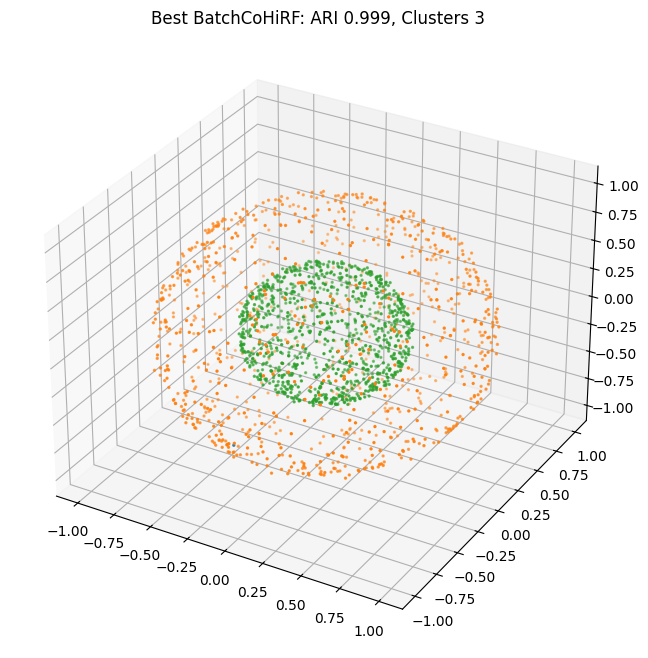

In [9]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

### Max iter = 1

In [9]:
random_state_model = 42000
batch_size = int(2e2)
model_cls = BatchCoHiRF
search_space = {
    "cohirf_kwargs": {
        "repetitions": optuna.distributions.IntDistribution(2, 10),
        "n_features": optuna.distributions.IntDistribution(2, 4),
        "base_model_kwargs": {
            "n_clusters": optuna.distributions.IntDistribution(2, 5),
        },
        "transform_kwargs": {
            "gamma": optuna.distributions.FloatDistribution(0.1, 30),
        },
    },
}
model_kwargs = {
    "cohirf_model": ModularCoHiRF,
    "cohirf_kwargs": dict(
        base_model=KMeans,
        transform_method=RBFSampler,
        transform_kwargs={"n_components": 500},
        representative_method="rbf",
        random_state=random_state_model,
        sample_than_transform=True,
        max_iter=1,
    ),
    "batch_size": batch_size,
}
training_fn_partial = partial(
    training_fn,
    model_cls=model_cls,
    model_kwargs=model_kwargs,
    X=X,
    y=y,
)
tuner = OptunaTuner(sampler="tpe", n_trials=20, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning: Argument ``constant_liar`` is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-06-02 19:25:19,016] A new study created in memory with name: no-name-0a93e865-6b9d-4e56-ab94-1d9e11472913


Trials:   0%|          | 0/20 [00:00<?, ?it/s]

Best parameters: {'cohirf_kwargs/repetitions': 3, 'cohirf_kwargs/n_features': 4, 'cohirf_kwargs/base_model_kwargs/n_clusters': 2, 'cohirf_kwargs/transform_kwargs/gamma': 1.8932432666012193}, Best Value: 1.000


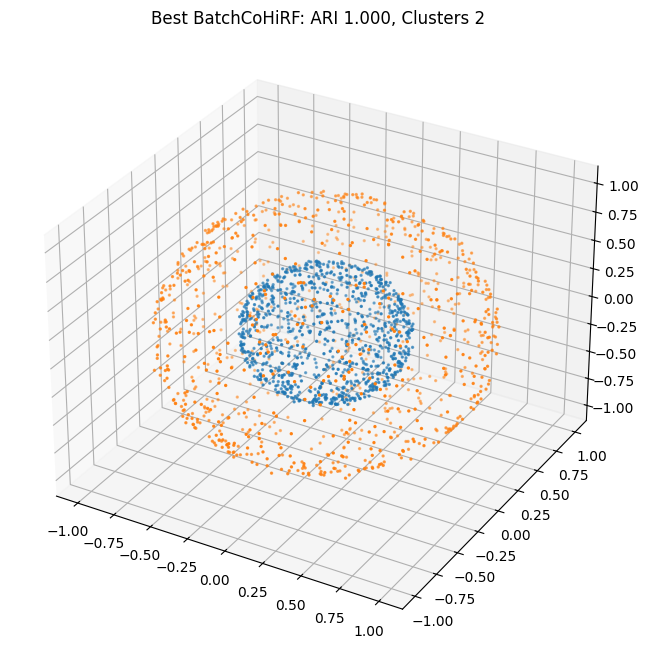

In [10]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## Batch CoHiRF Approx. Kernel KMeans Optimization first batch

In [47]:
random_state_model = 42000
batch_size = int(2e2)
model_cls = BatchCoHiRF
search_space = {
    "cohirf_kwargs": {
        "repetitions": optuna.distributions.IntDistribution(2, 10),
        "n_features": optuna.distributions.IntDistribution(2, 4),
        "base_model_kwargs": {
            "n_clusters": optuna.distributions.IntDistribution(2, 5),
        },
        "transform_kwargs": {
            "gamma": optuna.distributions.FloatDistribution(0.1, 30),
        },
    },
}
model_kwargs = {
    "cohirf_model": ModularCoHiRF,
    "cohirf_kwargs": dict(
        base_model=KMeans,
        transform_method=RBFSampler,
        transform_kwargs={"n_components": 500},
        representative_method="rbf",
        random_state=random_state_model,
        sample_than_transform=True,
        max_iter=1,
    ),
    "batch_size": batch_size,
}
X_first_batch = X[:3*batch_size]
y_first_batch = y[:3*batch_size]
training_fn_partial = partial(
    training_fn,
    model_cls=model_cls,
    model_kwargs=model_kwargs,
    X=X,
    y=y,
)
tuner = OptunaTuner(sampler="tpe", n_trials=20, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``multivariate`` is an experimental feature. The interface can change in the future.

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning:

Argument ``constant_liar`` is an experimental feature. The interface can change in the future.

[I 2025-06-02 18:43:17,127] A new study created in memory with name: no-name-a48f703d-750e-4fad-b590-814c69ce6d45


Trials:   0%|          | 0/20 [00:00<?, ?it/s]

Best parameters: {'cohirf_kwargs/repetitions': 3, 'cohirf_kwargs/n_features': 4, 'cohirf_kwargs/base_model_kwargs/n_clusters': 2, 'cohirf_kwargs/transform_kwargs/gamma': 1.8932432666012193}, Best Value: 1.000


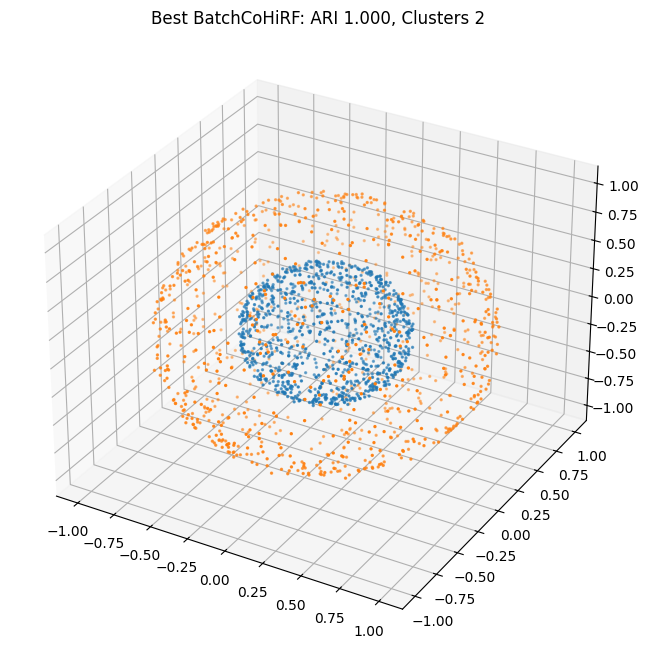

In [ ]:
"gamma": optuna.distributions.FloatDistribution(0.1, 30),

## Batch CoHiRF Approx. Kernel KMeans Optimization mean batchs

In [24]:
random_state_model = 42000
batch_size = int(2e2)
model_cls = BatchCoHiRF
search_space = {
    "cohirf_kwargs": {
        "repetitions": optuna.distributions.IntDistribution(2, 10),
        "n_features": optuna.distributions.IntDistribution(2, 4),
        "base_model_kwargs": {
            "n_clusters": optuna.distributions.IntDistribution(2, 5),
        },
        "transform_kwargs": {
            "gamma": optuna.distributions.FloatDistribution(0.1, 30),
        },
    },
}
model_kwargs = {
    "cohirf_model": ModularCoHiRF,
    "cohirf_kwargs": dict(
        base_model=KMeans,
        transform_method=RBFSampler,
        transform_kwargs={"n_components": 500},
        representative_method="rbf",
        random_state=random_state_model,
        sample_than_transform=True,
        max_iter=1,
    ),
    "batch_size": batch_size,
    "max_epochs": 1,
}
training_fn_partial = partial(
    training_fn_batch, model_cls=model_cls, model_kwargs=model_kwargs, X=X, y=y, batch_size=batch_size
)
tuner = OptunaTuner(sampler="tpe", n_trials=20, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning: Argument ``constant_liar`` is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-06-02 17:59:47,112] A new study created in memory with name: no-name-cd994e3b-2521-4e5b-a3d5-626c8af3841d


Trials:   0%|          | 0/20 [00:00<?, ?it/s]

Best parameters: {'cohirf_kwargs/repetitions': 3, 'cohirf_kwargs/n_features': 3, 'cohirf_kwargs/base_model_kwargs/n_clusters': 2, 'cohirf_kwargs/transform_kwargs/gamma': 8.06069288108497}, Best Value: 0.412
Starting epoch 0
Starting epoch 1
Getting labels from parents


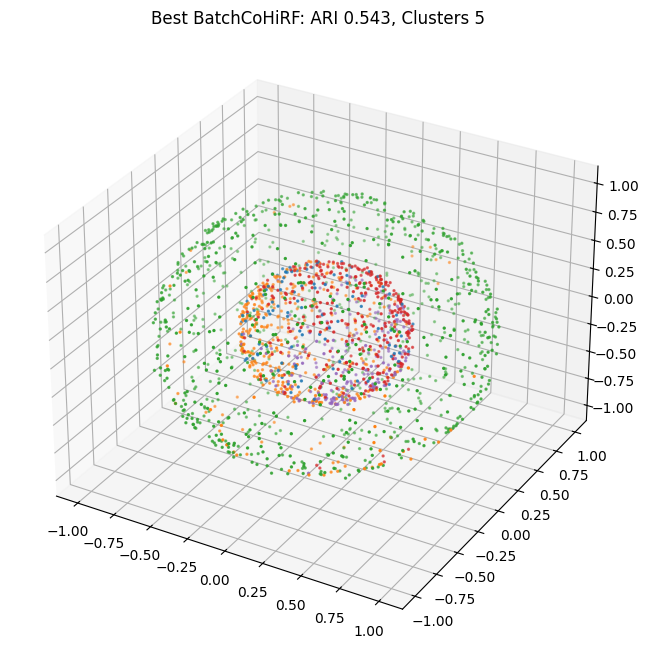

In [25]:
model_kwargs["max_epochs"] = 10
model_kwargs["verbose"] = True
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## Batch CoHiRF Kernel KMeans

In [11]:
random_state_model = 42000
batch_size = int(2e2)
model_cls = BatchCoHiRF
search_space = {
    "cohirf_kwargs": {
        "repetitions": optuna.distributions.IntDistribution(2, 5),
        "n_features": optuna.distributions.IntDistribution(2, 4),
        "base_model_kwargs": {
            "n_clusters": optuna.distributions.IntDistribution(2, 5),
            "gamma": optuna.distributions.FloatDistribution(0.1, 30),
        },
    },
}
model_kwargs = {
    "cohirf_model": ModularCoHiRF,
    "cohirf_kwargs": dict(
        base_model=KernelKMeans,
        representative_method="rbf",
        random_state=random_state_model,
        sample_than_transform=True,
        # max_iter=1,
    ),
    "batch_size": batch_size,
    "n_jobs": 10,
}
training_fn_partial = partial(
    training_fn,
    model_cls=model_cls,
    model_kwargs=model_kwargs,
    X=X,
    y=y,
)
tuner = OptunaTuner(sampler="tpe", n_trials=50, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning: Argument ``constant_liar`` is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-06-02 19:26:34,616] A new study created in memory with name: no-name-1d8e474c-ef88-48ce-a2b3-179f67abef18


Trials:   0%|          | 0/50 [00:00<?, ?it/s]

Best parameters: {'cohirf_kwargs/repetitions': 4, 'cohirf_kwargs/n_features': 3, 'cohirf_kwargs/base_model_kwargs/n_clusters': 3, 'cohirf_kwargs/base_model_kwargs/gamma': 18.398212036488005}, Best Value: 0.550


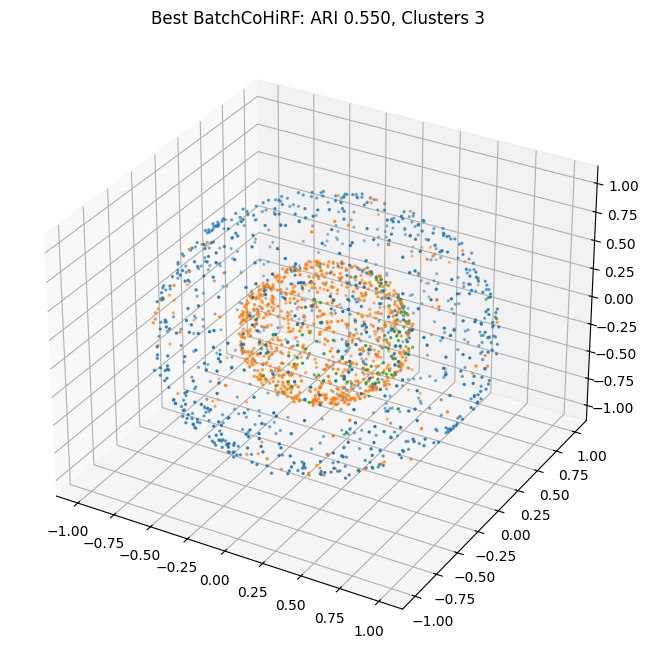

In [12]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

#  Dataset Large

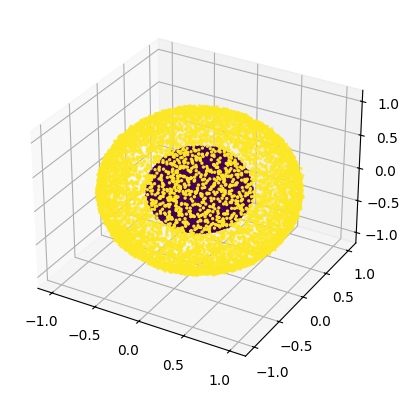

In [26]:
# dataset parameters
mean_r = [0.5, 1]  # Mean radii of the spheres
std = 0.01  # Standard deviation for the radii
seed_dataset = 42
n_samples = int(2e4)
n_samples_per_sphere = int(n_samples / 2)  # Number of samples per sphere
X, y = generate_spherical_clusters(mean_r, std, num_points_per_sphere=n_samples_per_sphere, seed=seed_dataset)

visualize_3d_data(X, y)

## DBSCAN

In [43]:
random_state_model = 42000
model_cls = DBSCAN
search_space = {
    "eps": optuna.distributions.FloatDistribution(1e-1, 10),
    "min_samples": optuna.distributions.IntDistribution(5, 50),
}
model_kwargs = {
    "n_jobs": 10,
}
training_fn_partial = partial(training_fn, model_cls=model_cls, model_kwargs=model_kwargs, X=X, y=y)
tuner = OptunaTuner(sampler="tpe", n_trials=20, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning: Argument ``constant_liar`` is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-06-02 18:13:22,887] A new study created in memory with name: no-name-b384ec51-a04f-497a-b20f-43eacec2c5fa


Trials:   0%|          | 0/20 [00:00<?, ?it/s]

Best parameters: {'eps': 0.27609249175355666, 'min_samples': 8}, Best Value: 1.000


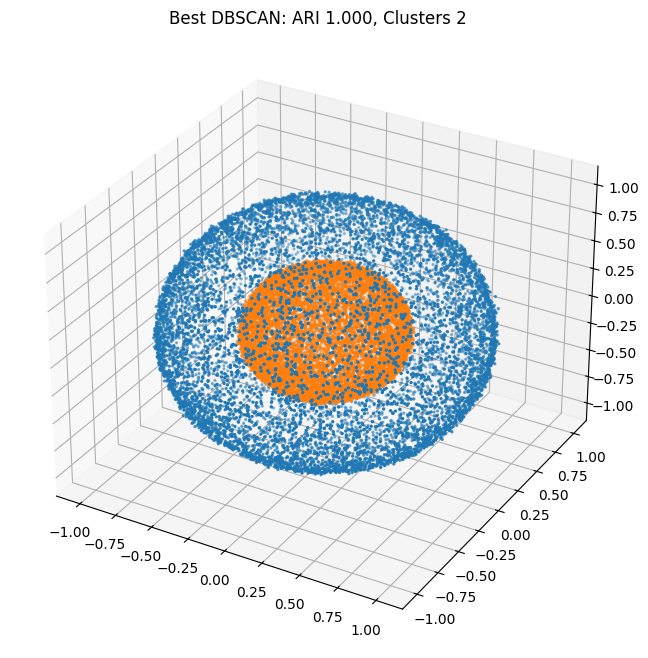

In [44]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

## Batch CoHiRF DBSCAN

In [45]:
random_state_model = 42000
batch_size = int(1e3)
model_cls = BatchCoHiRF
search_space = {
    "cohirf_kwargs": {
        "base_model_kwargs": {
            "eps": optuna.distributions.FloatDistribution(1e-1, 10),
            "min_samples": optuna.distributions.IntDistribution(5, 50),
        },
        "n_features": optuna.distributions.IntDistribution(1, 3),
    },
}
model_kwargs = {
    "cohirf_model": ModularCoHiRF,
    "cohirf_kwargs": dict(base_model=DBSCAN, random_state=random_state_model, repetitions=1, max_iter=1),
    "batch_size": batch_size,
    "n_jobs": 10,
}

training_fn_partial = partial(
    training_fn, model_cls=model_cls, model_kwargs=model_kwargs, X=X, y=y
)
tuner = OptunaTuner(sampler="tpe", n_trials=100, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning: Argument ``constant_liar`` is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-06-02 18:14:42,263] A new study created in memory with name: no-name-999ed9fd-ed5d-4f39-b520-fb1afd44f71a


Trials:   0%|          | 0/100 [00:00<?, ?it/s]

Best parameters: {'cohirf_kwargs/base_model_kwargs/eps': 0.40270122597233515, 'cohirf_kwargs/base_model_kwargs/min_samples': 34, 'cohirf_kwargs/n_features': 3}, Best Value: 1.000
Starting epoch 0
Starting epoch 1
Starting epoch 2
Getting labels from parents


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  19 out of  19 | elapsed:    0.1s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done   8 out of   8 | elapsed:    0.0s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.


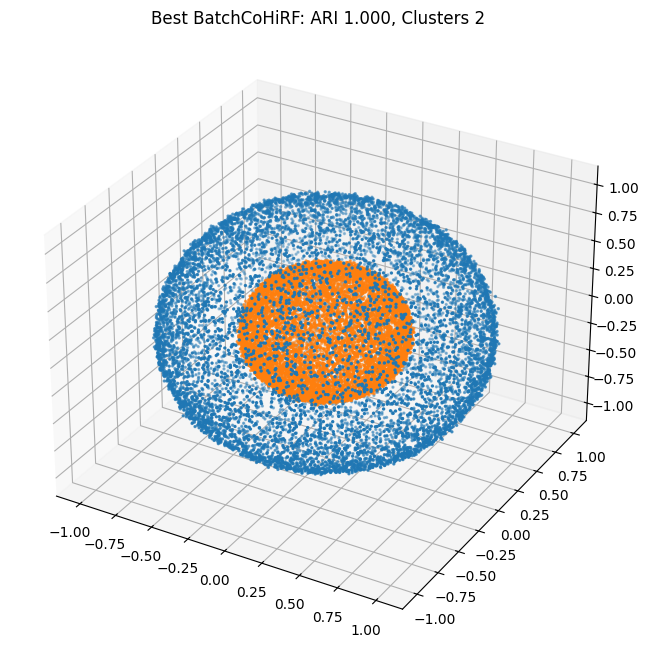

In [46]:
model_kwargs["verbose"] = True
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

# Dataset 3 spheres

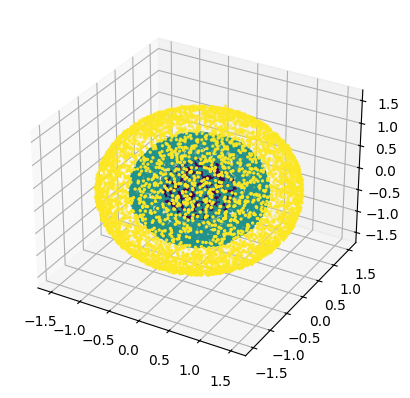

In [5]:
# dataset parameters
mean_r = [0.5, 1, 1.5]  # Mean radii of the spheres
std = 0.01  # Standard deviation for the radii
seed_dataset = 42
n_samples = int(2e4)
n_samples_per_sphere = int(n_samples / 3)  # Number of samples per sphere
X, y = generate_spherical_clusters(mean_r, std, num_points_per_sphere=n_samples_per_sphere, seed=seed_dataset)

visualize_3d_data(X, y)

## DBSCAN


In [6]:
random_state_model = 42000
model_cls = DBSCAN
search_space = {
    "eps": optuna.distributions.FloatDistribution(1e-1, 10),
    "min_samples": optuna.distributions.IntDistribution(5, 50),
}
model_kwargs = {
    "n_jobs": 10,
}
training_fn_partial = partial(training_fn, model_cls=model_cls, model_kwargs=model_kwargs, X=X, y=y)
tuner = OptunaTuner(sampler="tpe", n_trials=20, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning: Argument ``constant_liar`` is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-06-02 19:00:18,712] A new study created in memory with name: no-name-7939c7ce-eab2-4374-817b-5785db1eb8c0


Trials:   0%|          | 0/20 [00:00<?, ?it/s]

Best parameters: {'eps': 0.27609249175355666, 'min_samples': 8}, Best Value: 1.000


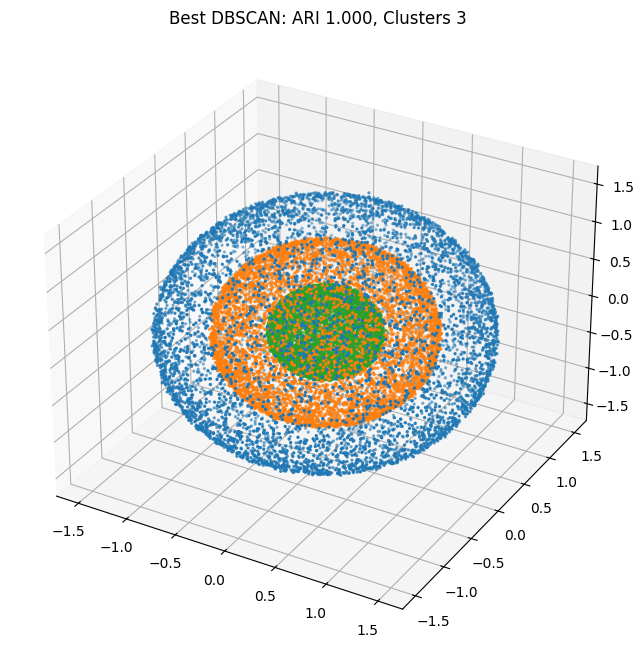

In [7]:
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)

In [10]:
random_state_model = 42000
batch_size = int(1e3)
model_cls = BatchCoHiRF
search_space = {
    "cohirf_kwargs": {
        "base_model_kwargs": {
            "eps": optuna.distributions.FloatDistribution(1e-1, 1),
            "min_samples": optuna.distributions.IntDistribution(5, 20),
        },
        "n_features": optuna.distributions.IntDistribution(1, 3),
    },
}
model_kwargs = {
    "cohirf_model": ModularCoHiRF,
    "cohirf_kwargs": dict(base_model=DBSCAN, random_state=random_state_model, repetitions=1, max_iter=1),
    "batch_size": batch_size,
    "n_jobs": 10,
}

training_fn_partial = partial(training_fn, model_cls=model_cls, model_kwargs=model_kwargs, X=X, y=y)
tuner = OptunaTuner(sampler="tpe", n_trials=100, seed=random_state_model)
study = tuner.tune(training_fn=training_fn_partial, search_space=search_space, direction="maximize")

/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning: Argument ``multivariate`` is an experimental feature. The interface can change in the future.
  warnings.warn(
/home/belucci/miniconda3/envs/cohirf/lib/python3.11/site-packages/optuna/_experimental.py:31: ExperimentalWarning: Argument ``constant_liar`` is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-06-02 19:02:38,126] A new study created in memory with name: no-name-2719acc7-fe32-4e49-8687-3844ec1ddcdf


Trials:   0%|          | 0/100 [00:00<?, ?it/s]

Best parameters: {'cohirf_kwargs/base_model_kwargs/eps': 0.43115652176910846, 'cohirf_kwargs/base_model_kwargs/min_samples': 8, 'cohirf_kwargs/n_features': 3}, Best Value: 1.000
Starting epoch 0
Starting epoch 1
Starting epoch 2
Getting labels from parents


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  18 out of  18 | elapsed:    0.1s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.


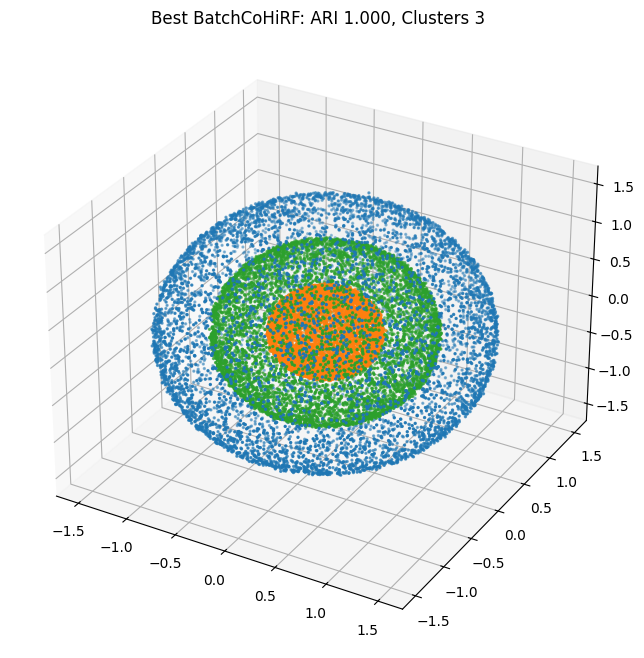

In [11]:
model_kwargs["verbose"] = True
best_model, labels = train_best_model_and_show_results(model_cls, model_kwargs, study, X, y)